In this step, we create various types of graphs to explore the outcomes of topic modeling.

In [139]:
# set up the environment 
# Read the content of the setup script
setup_script = 'Setup/step3.py'

with open(setup_script, 'r') as file:
    setup_code = file.read()

# Execute the setup script
exec(setup_code)

yes


Load the variables and models. 

In [138]:
# Load the corpus object
with open("ProcessedData/corpus.pkl", "rb") as f:
    corpus = pickle.load(f)

# Load the final object
with open("ProcessedData/final.pkl", "rb") as f:
    final = pickle.load(f)


lda_model = models.LdaModel.load("ProcessedData/ldamodel")    
nmf_model = models.nmf.Nmf.load("ProcessedData/nmfmodel")    

The first graphs will be word clouds. Each topic is composed of different words with various weights. The word cloud can visualize this.

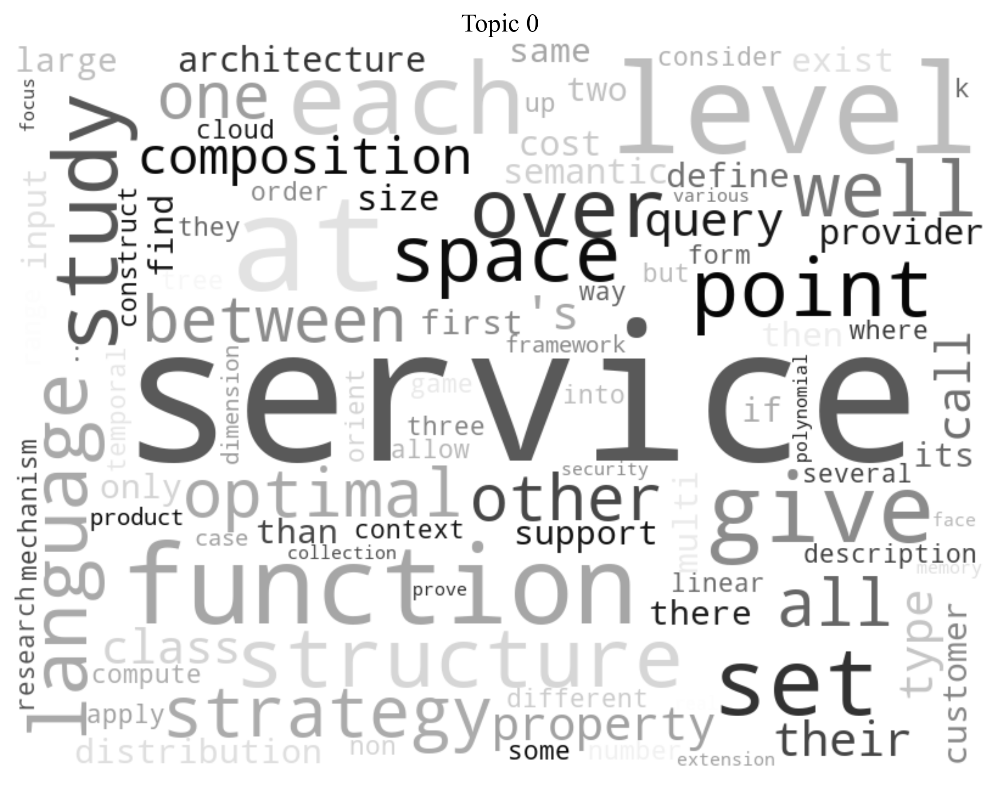

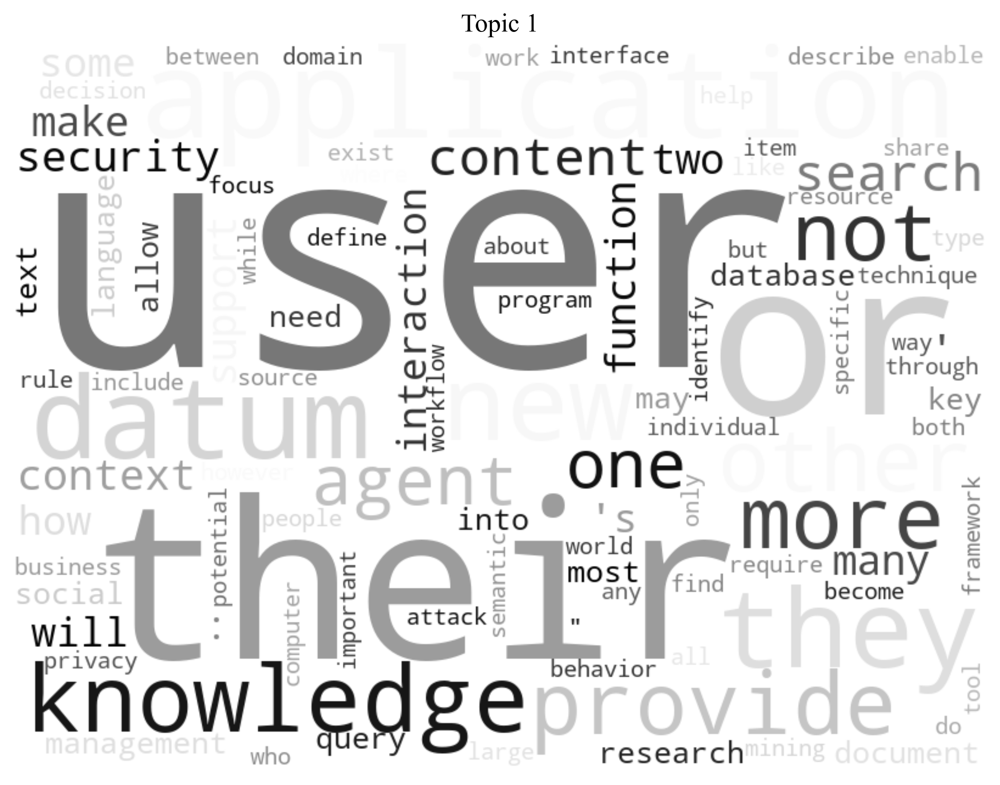

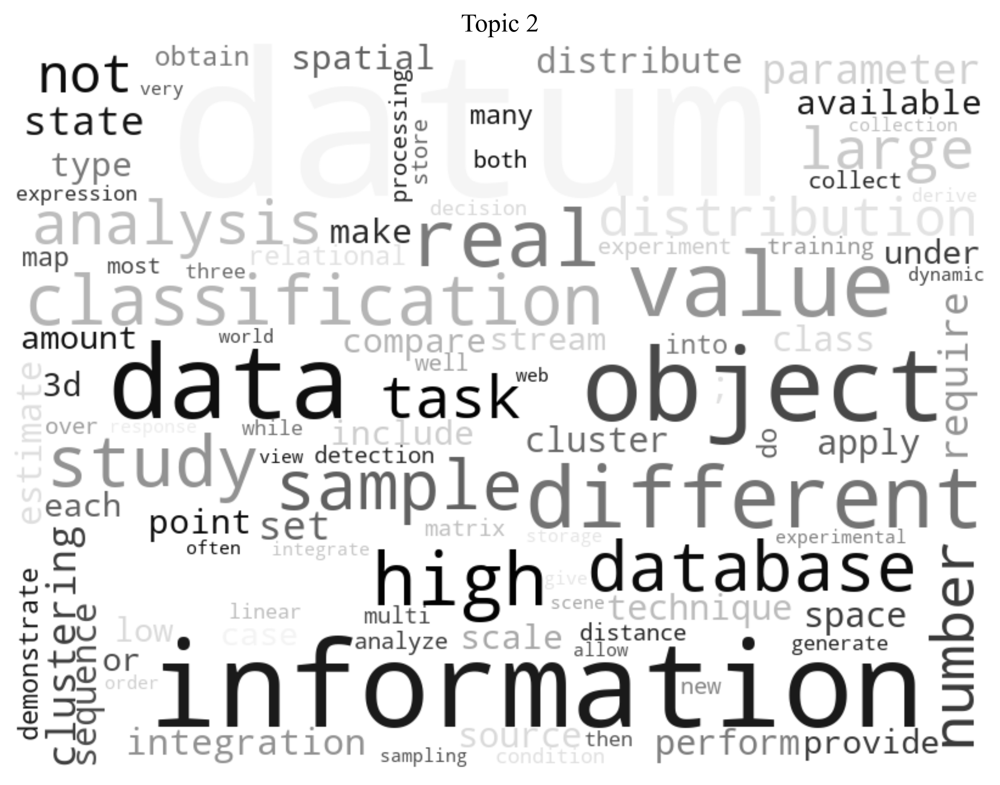

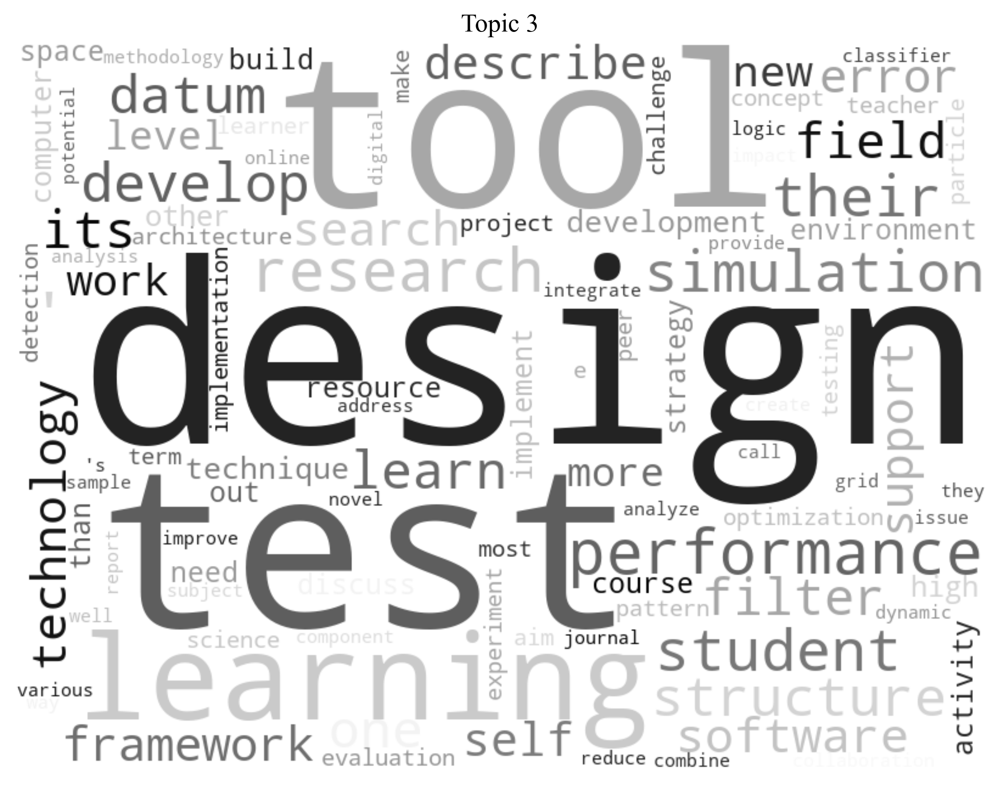

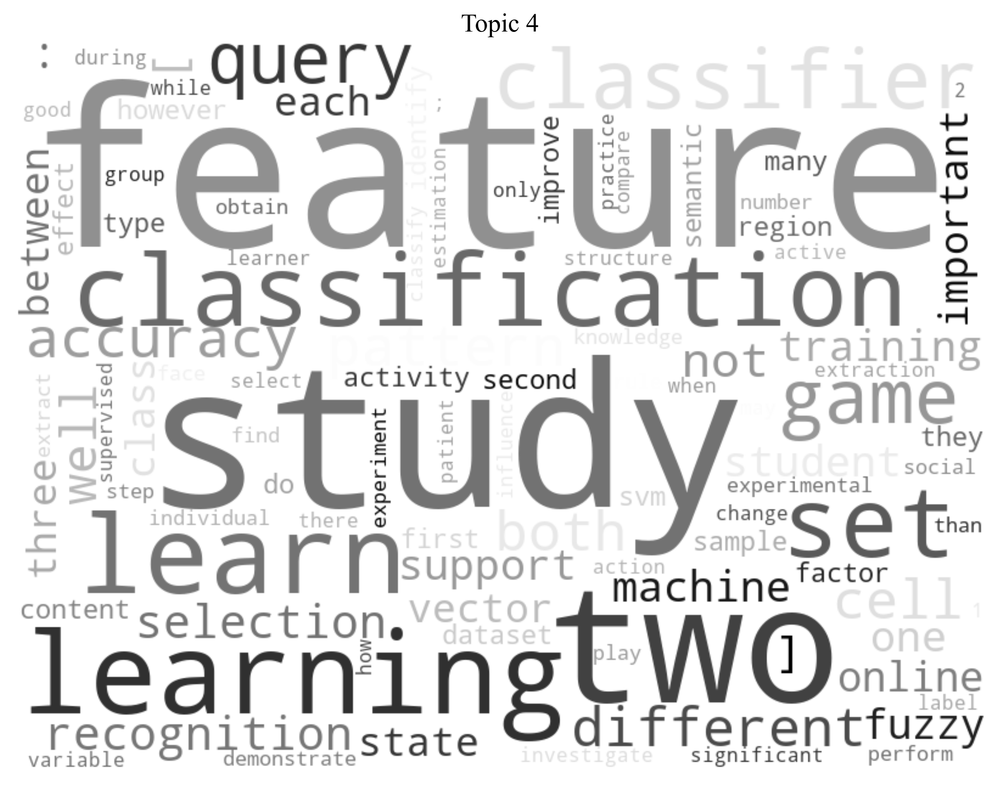

...

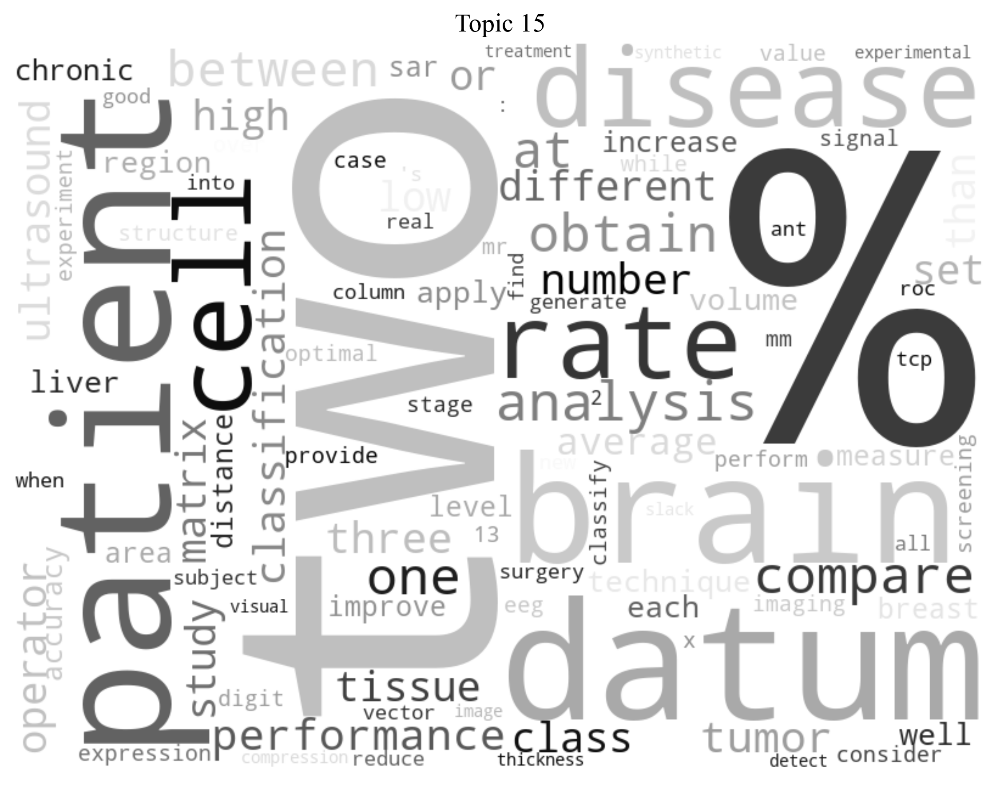

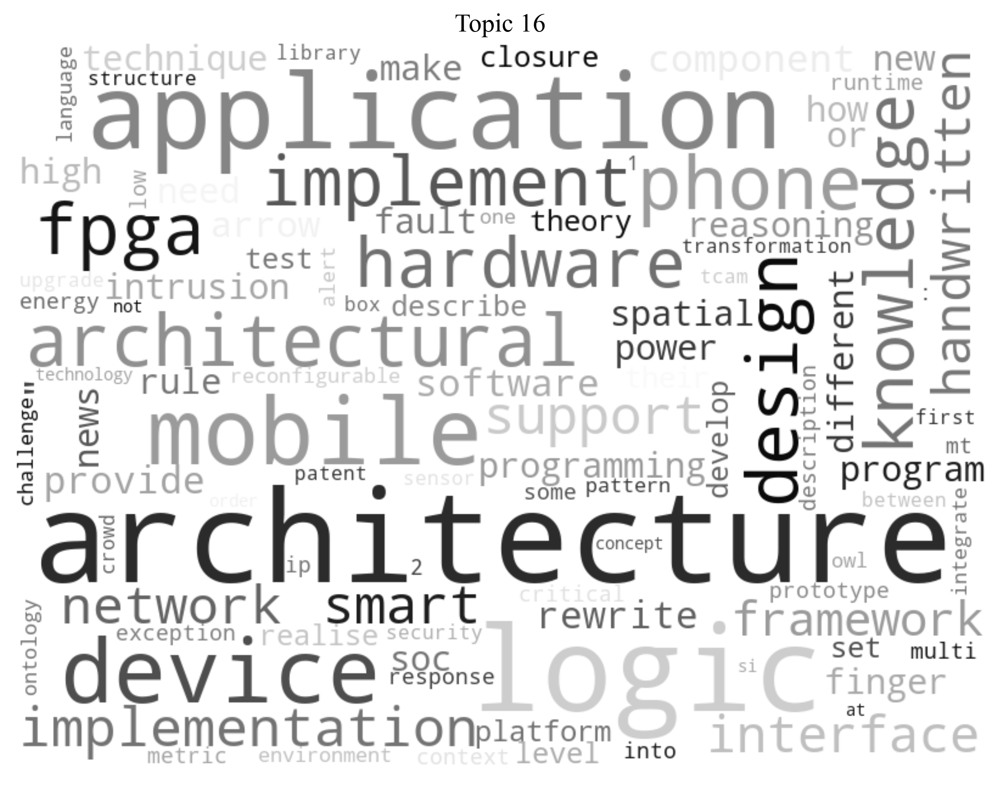

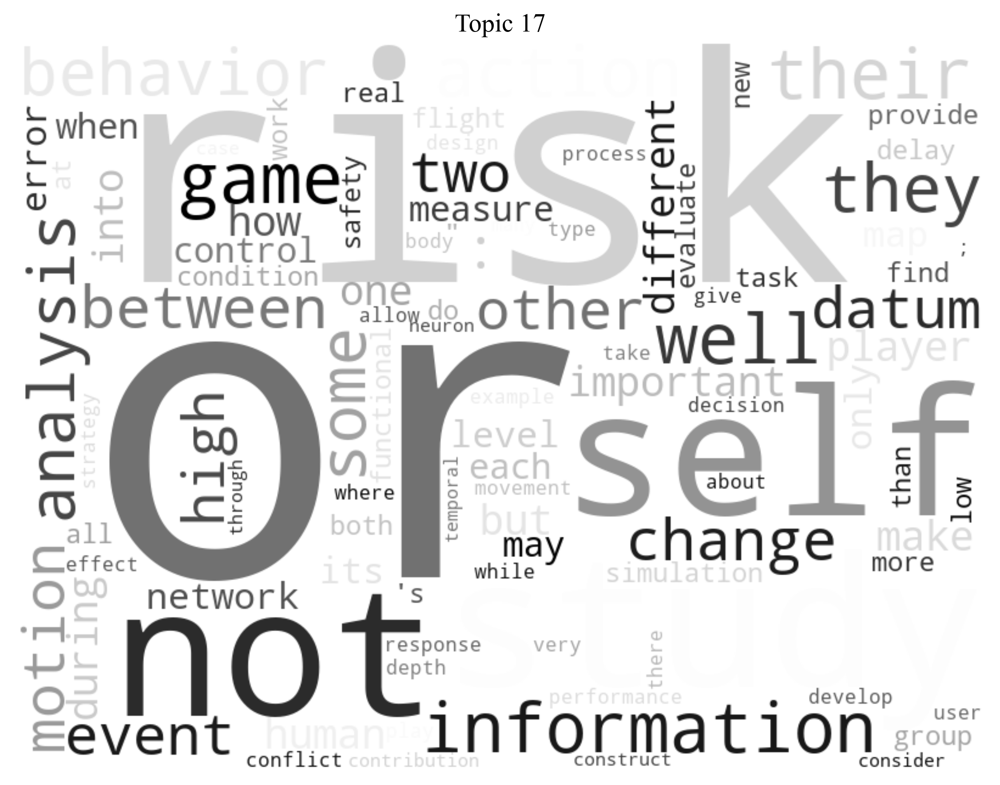

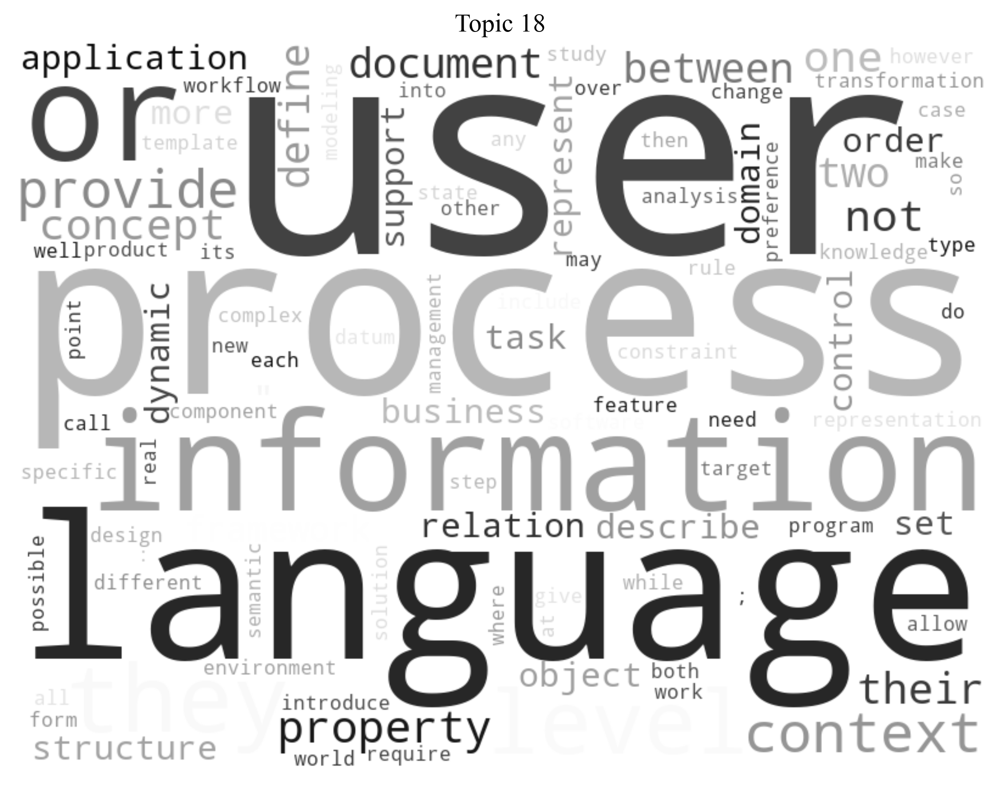

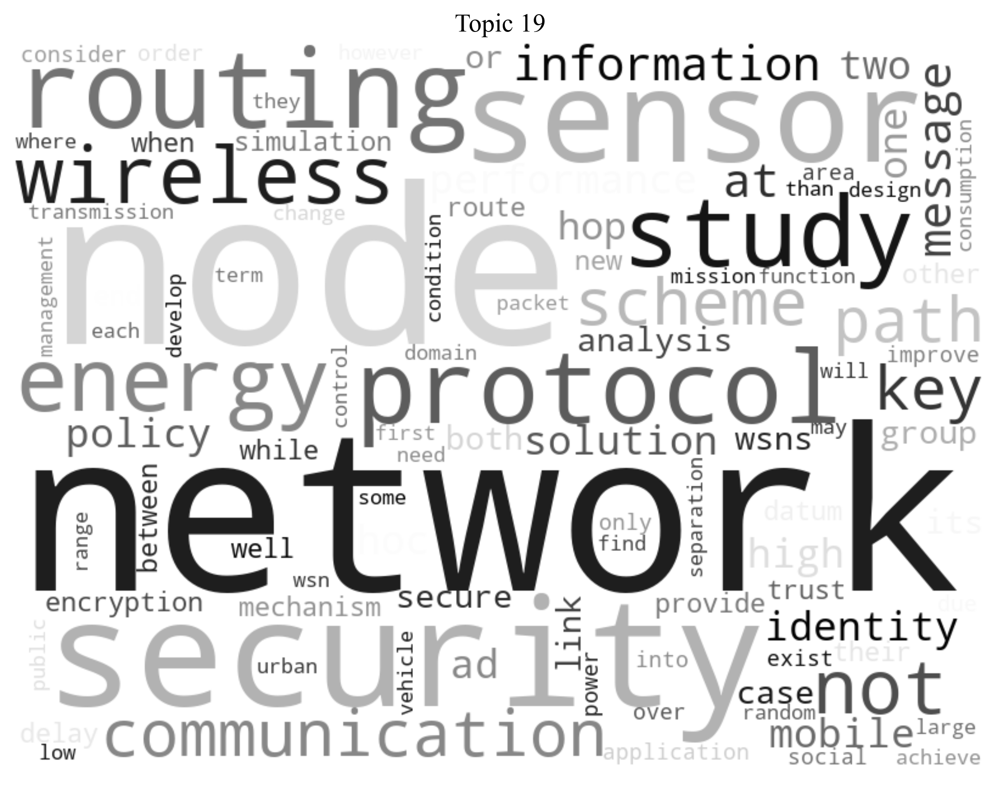

In [22]:


plot_wordcloud(nmf_model,"Graphs/NMF")
plot_wordcloud(lda_model,"Graphs/LDA")

The topics can also be visualized in a more quantitative way where the weights of top ten key workds are presented. As a reference, the term frequency is also presented.

In [31]:

plotbar(nmf_model,final,"Graphs/NMF")
plotbar(lda_model,final,"Graphs/LDA")

The bar plots generated above represent each individual topic. The following bar plot provides an overview of all topic loadings across the entire corpus, offering a global perspective.

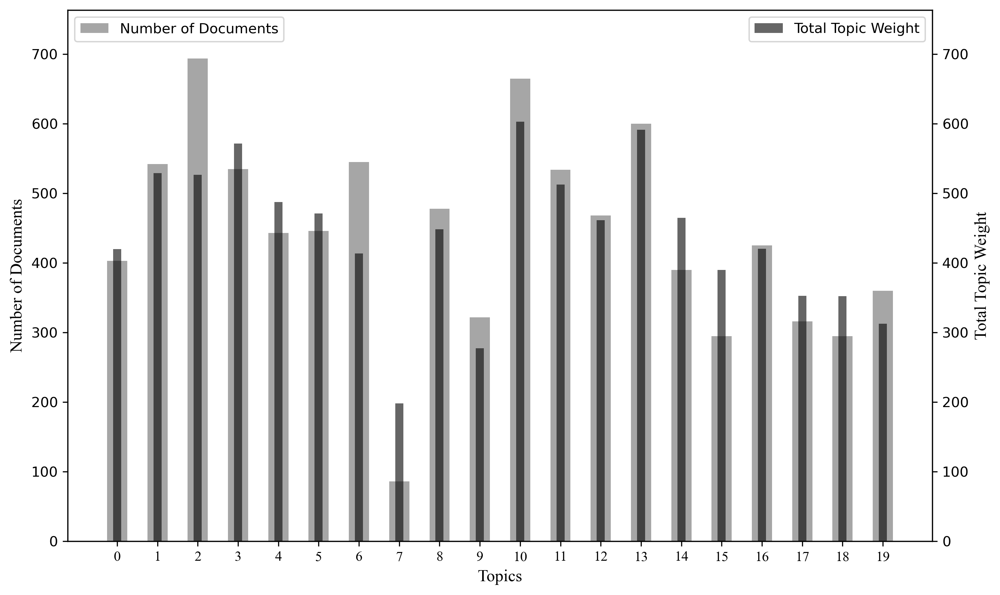

topic_id,words,weight
0,"service, at, level, function, each, give, set",0.101691
1,"user, their, or, application, datum, they, new",0.089889
2,"datum, information, data, object, value, different, real",0.124107
3,"design, test, tool, learning, performance, research, student",0.076970
4,"feature, study, two, learning, learn, classification, set",0.086665
5,"design, product, user, software, or, provide, study",0.106154
6,"image, feature, application, high, sensor, technique, face",0.116602
7,"$, {, }, set, at, state, code",0.110390
8,"control, function, controller, parameter, motion, dynamic, robot",0.104279
9,""", service, new, between, information, process, not",0.112612


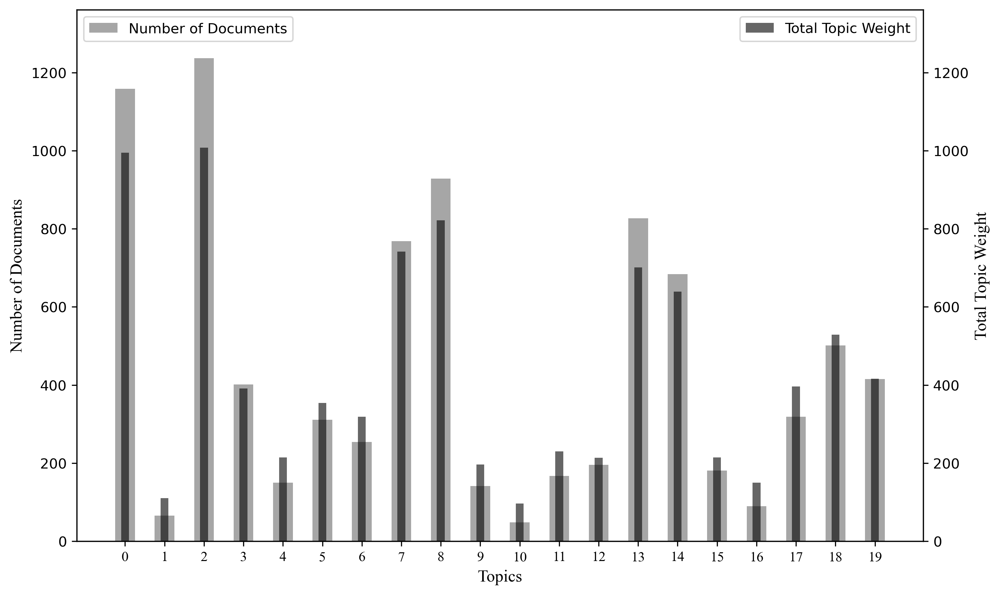

topic_id,words,weight
0,"study, network, their, research, ', new, technology",0.045771
1,"signal, noise, speech, transform, frequency, band, eye",0.123645
2,"control, function, set, robot, state, design, space",0.045791
3,"$, design, high, at, /, video, processor",0.046259
4,"peer, network, two, more, performance, :, study",0.043602
5,"tree, query, datum, class, performance, estimation, translation",0.054457
6,""", network, agent, program, not, performance, or",0.054785
7,"datum, software, analysis, design, application, data, process",0.061304
8,"service, user, information, web, search, provide, network",0.074992
9,"signal, parameter, delay, output, water, fuzzy, adaptive",0.060860


In [140]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import os
from IPython.display import display, HTML

def plottopicdocument2(model, corpus, folderpath=None):
    """
    This function visualizes the distribution of topics in a set of documents using a given topic model. 
    It plots two main aspects:
    1. The number of documents dominated by each topic.
    2. The total weightage of each topic across all documents.
    It also generates an APA-style table listing the top seven words for each topic along with their weights.

    Parameters:
    model (gensim model): The topic model to visualize.
    corpus (list of list of (int, int)): The corpus in BOW format.
    folderpath (str, optional): The directory to save the plots. If not provided, the plots are displayed.
    """
    # Extract dominant topics and topic percentages
    dominant_topics, topic_percentages = topics_per_document(model=model, corpus=corpus)
    
    # Distribution of Dominant Topics in Each Document
    df = pd.DataFrame(dominant_topics, columns=['Document_Id', 'Dominant_Topic'])
    dominant_topic_in_each_doc = df.groupby('Dominant_Topic').size()
    df_dominant_topic_in_each_doc = dominant_topic_in_each_doc.to_frame(name='count').reset_index()
    
    # Total Topic Distribution by actual weight
    topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages])
    df_topic_weightage_by_doc = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()
    
    # Top 7 Keywords for each Topic with their weights
    num_topics = model.num_topics
    topic_top7words = [(i, topic, wt) for i, topics in model.show_topics(formatted=False, num_topics=num_topics) 
                       for j, (topic, wt) in enumerate(topics) if j < 7]
    
    df_top7words_stacked = pd.DataFrame(topic_top7words, columns=['topic_id', 'words', 'weight'])
    df_top7words = df_top7words_stacked.groupby('topic_id').agg({
        'words': ', '.join,
        'weight': lambda x: ', '.join([f"{w:.4f}" for w in x]),
        'weight': 'sum'
    }).reset_index()
    
    # APA style settings
    plt.style.use('default')
    
    fig, ax1 = plt.subplots(1, 1, figsize=(10, 6), dpi=300, sharey=True)
    
    # Topic Distribution by Dominant Topics
    ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=0.5, color='gray', alpha=0.7, label='Number of Documents')
    ax1.set_xticks(df_dominant_topic_in_each_doc['Dominant_Topic'])
    tick_formatter = FuncFormatter(lambda x, pos: str(int(x)))
    ax1.xaxis.set_major_formatter(tick_formatter)
    ax1.set_ylabel('Number of Documents', fontsize=12, fontname='Times New Roman', color='black')
    ax1.set_xlabel('Topics', fontsize=12, fontname='Times New Roman', color='black')
    ax1.legend(loc='upper left', fontsize=10)
    ax1.tick_params(axis='both', which='major', labelsize=10, labelcolor='black')
    ax1.grid(False)  # Remove gridlines
    plt.setp(ax1.get_xticklabels(), rotation=0, ha='center', fontsize=10, fontname='Times New Roman')
    
    # Total Topic Distribution by Weights
    ax_twin = ax1.twinx()
    ax_twin.bar(x='index', height="count", data=df_topic_weightage_by_doc, color='black', width=0.2, alpha=0.6, label='Total Topic Weight')
    ax_twin.set_ylabel('Total Topic Weight', fontsize=12, fontname='Times New Roman', color='black')
    ax_twin.legend(loc='upper right', fontsize=10)
    ax_twin.tick_params(axis='both', which='major', labelsize=10, labelcolor='black')
    ax_twin.grid(False)  # Remove gridlines
    
    # Set uniform y-axis limits
    max_height = max(df_dominant_topic_in_each_doc['count'].max(), df_topic_weightage_by_doc['count'].max()) * 1.1
    ax1.set_ylim(0, max_height)
    ax_twin.set_ylim(0, max_height)
    
    plt.tight_layout()
    
    # Save or display the plot
    if folderpath:
        if not os.path.exists(folderpath):
            os.makedirs(folderpath)
        plt.savefig(os.path.join(folderpath, 'topic_document_distribution.png'), bbox_inches='tight')
        plt.show()
    else:
        plt.show()
    
    # Close the figure after saving or displaying
    plt.close(fig)
    
    # Generate APA-style table for top seven words per topic with their weights
    table_html = df_top7words.to_html(index=False, justify='center')
    display(HTML(f"""
    <style>
        table {{
            width: 70%;
            border-collapse: collapse;
            margin: 25px 0;
            font-size: 16px;
            text-align: center;
        }}
        table, th, td {{
            border: 1px solid black;
        }}
        th, td {{
            padding: 12px 15px;
        }}
        thead {{
            background-color: #f2f2f2;
        }}
    </style>
    <h2>Table 1</h2>
    <p>Top Seven Words for Each Topic with Weights</p>
    {table_html}
    """))

    return None

plottopicdocument2(nmf_model,corpus,"Graphs/NMF")
plottopicdocument2(lda_model,corpus,"Graphs/LDA")

Next, it is beneficial to visualize all the papers based on the topic loadings using t-SNE. t-SNE is an effective method for such visualizations.

In [142]:
plottsne(lda_model,corpus)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.093s...
[t-SNE] Computed neighbors for 8842 samples in 2.188s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.104740
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.073883


The following visualization includes additional legend information for better clarity.

In [47]:

showtsne(lda_model,corpus,legend=True)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.099s...
[t-SNE] Computed neighbors for 8842 samples in 1.852s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.104725
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.068100
[t-SNE] KL divergence after 1000 iterations: 1.792944


Now, we will investigate whether the topics of papers influence their citation counts. Specifically, we aim to determine if the subject matter of a paper contributes to an increase in the number of citations it receives.

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.100s...
[t-SNE] Computed neighbors for 8842 samples in 1.868s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.104573
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.071762
[t-SNE] KL divergence after 1000 iterations: 1.802167


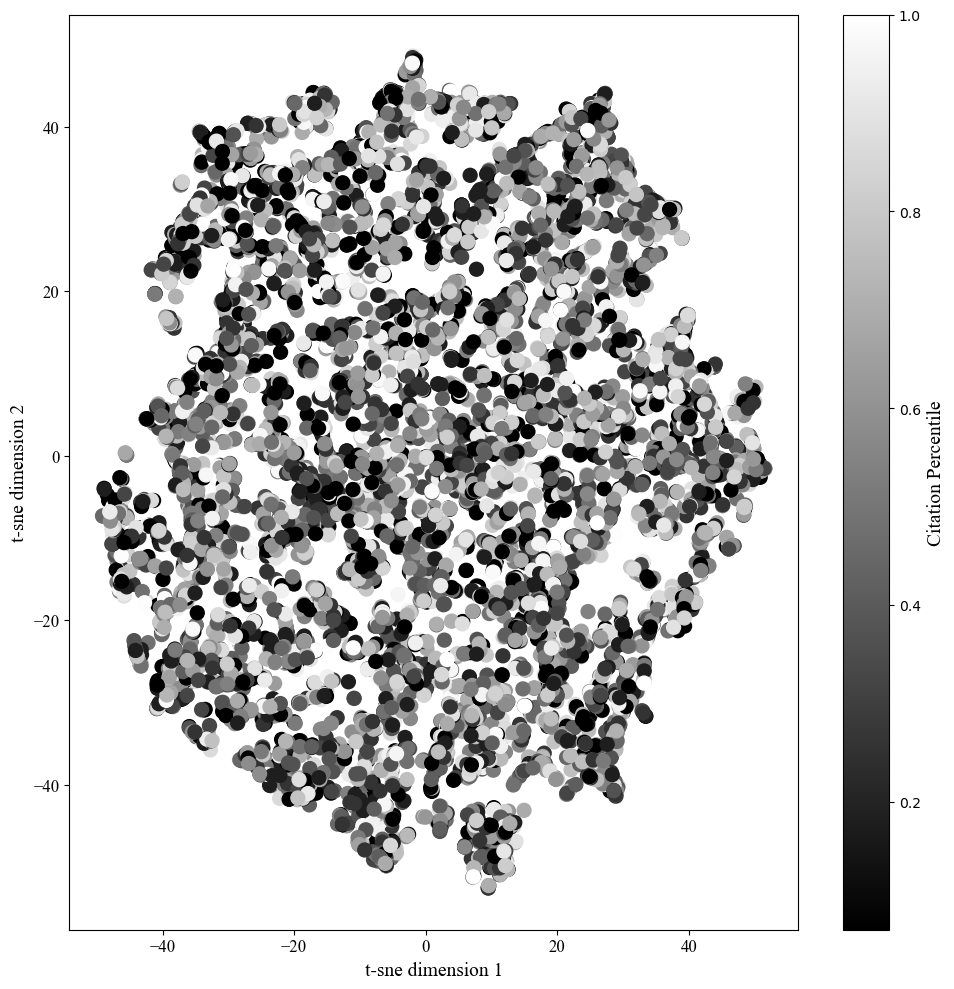

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.145s...
[t-SNE] Computed neighbors for 8842 samples in 3.005s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.108217
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.018631
[t-SNE] KL divergence after 1000 iterations: 2.139595


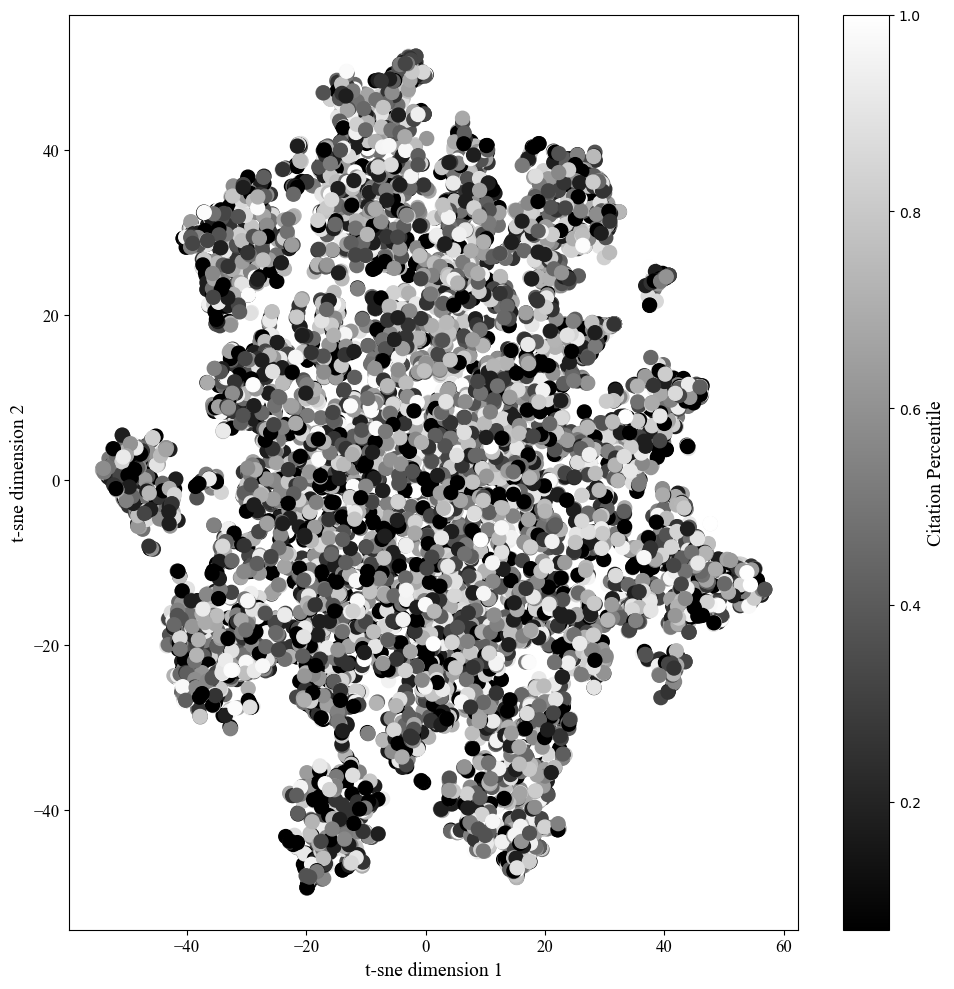

In [73]:
citation = pd.read_csv('ProcessedData/n_citation_data.csv')
plot_citation_percentiles(lda_model, corpus, citation["n_citation"],color='gray',file='Graphs/LDA/lda_citation_percentiles.png')
plot_citation_percentiles(nmf_model, corpus, citation["n_citation"],color='gray',file='Graphs/NMF/nmf_citation_percentiles.png')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.101s...
[t-SNE] Computed neighbors for 8842 samples in 1.865s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.104820
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.067352
[t-SNE] KL divergence after 1000 iterations: 1.810456


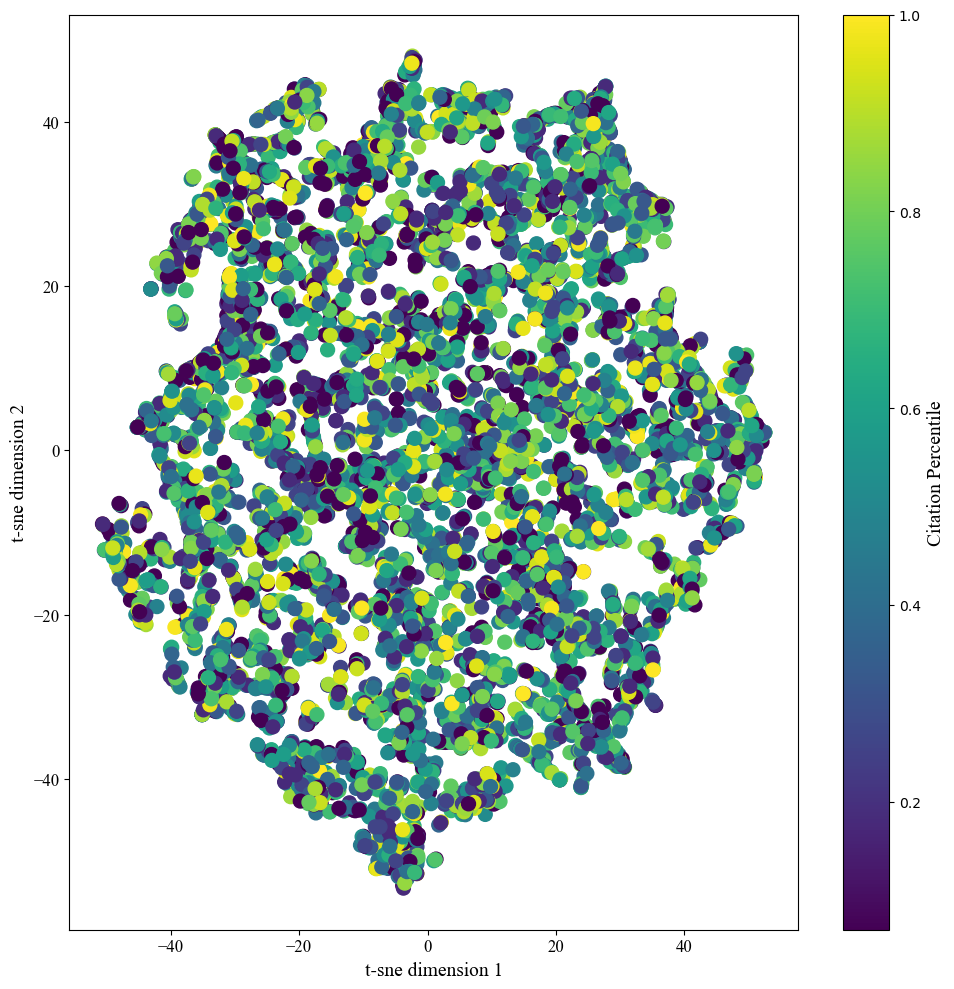

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8842 samples in 0.170s...
[t-SNE] Computed neighbors for 8842 samples in 3.391s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8842
[t-SNE] Computed conditional probabilities for sample 2000 / 8842
[t-SNE] Computed conditional probabilities for sample 3000 / 8842
[t-SNE] Computed conditional probabilities for sample 4000 / 8842
[t-SNE] Computed conditional probabilities for sample 5000 / 8842
[t-SNE] Computed conditional probabilities for sample 6000 / 8842
[t-SNE] Computed conditional probabilities for sample 7000 / 8842
[t-SNE] Computed conditional probabilities for sample 8000 / 8842
[t-SNE] Computed conditional probabilities for sample 8842 / 8842
[t-SNE] Mean sigma: 0.108168
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.136108
[t-SNE] KL divergence after 1000 iterations: 2.161277


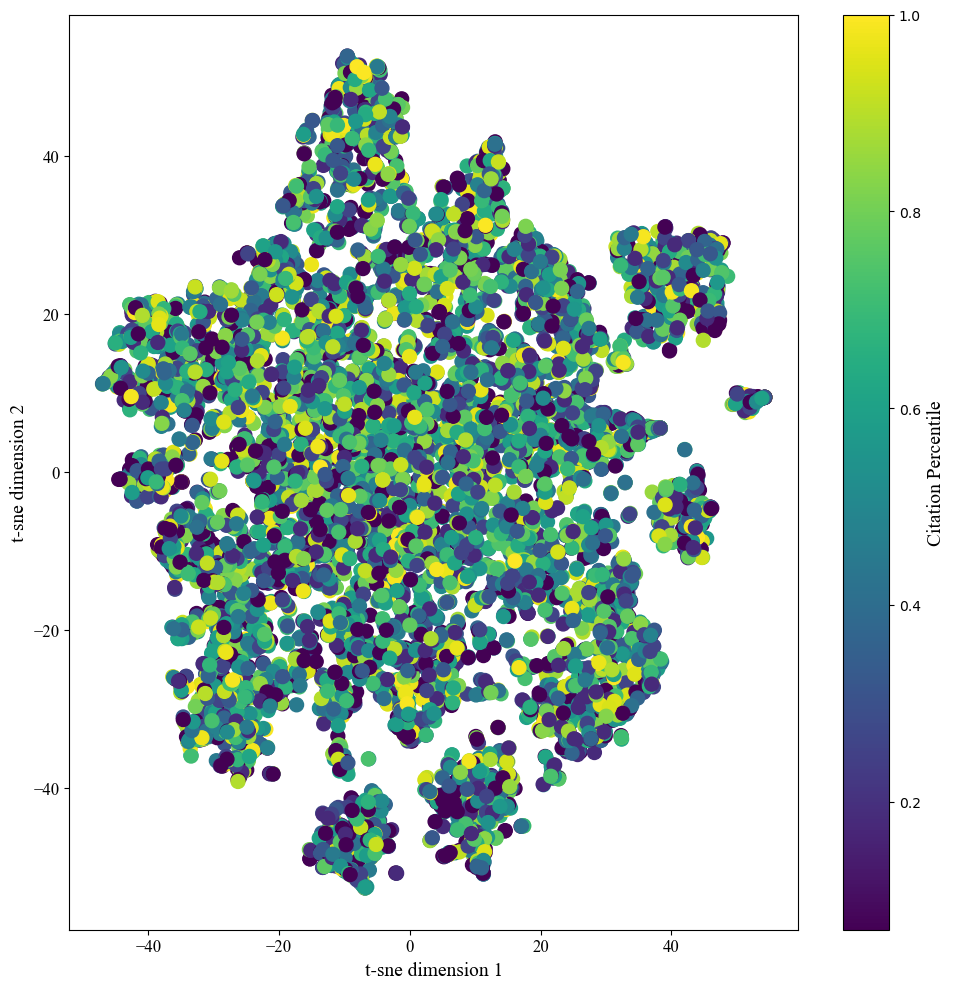

In [74]:
plot_citation_percentiles(lda_model, corpus, citation["n_citation"],file='Graphs/LDA/lda_citation_percentiles_color.png')
plot_citation_percentiles(nmf_model, corpus, citation["n_citation"],file='Graphs/NMF/nmf_citation_percentiles_color.png')

Based on the output, visually speaking, we don't see a clear pattern between the topics and the number of citations. This suggests that the relationship between a paper's subject matter and its citation count may not be straightforward. In the next step, we will employ other statistical analysis tools to delve deeper into this relationship. By using methods such as regression analysis or correlation tests, we aim to uncover any underlying patterns or trends that may not be immediately apparent from the visual data alone. This comprehensive approach will help us better understand the factors that influence citation counts.

In [48]:
EN = pd.read_csv('ProcessedData/abstract_data.csv')

In [66]:
print("paper 1:",EN['Abstract'][1431])
print("paper 2:",EN['Abstract'][6722])
print("paper 3:",EN['Abstract'][6180])


paper 1: Recent progress in per-pixel object class labeling of natural images can be attributed to the use of multiple types of image features and sound statistical learning approaches. Within the latter, Conditional Random Fields (CRF) are prominently used for their ability to represent interactions between random variables. Despite their popularity in computer vision, parameter learning for CRFs has remained difficult, popular approaches being cross-validation and piecewise training. In this work, we propose a simple yet expressive tree-structured CRF based on a recent hierarchical image segmentation method. Our model combines and weights multiple image features within a hierarchical representation and allows simple and efficient globally-optimal learning of ≅ 105 parameters. The tractability of our model allows us to pose and answer some of the open questions regarding parameter learning applying to CRF-based approaches. The key findings for learning CRF models are, from the obvious

In [141]:
# Number of topics and top words
num_topics = 20
num_words = 10

# Retrieve and print the topics with their top words and weights
topics = lda_model.show_topics(num_topics=num_topics, num_words=num_words, formatted=False)
for topic_num, words in topics:
    print(f"Topic {topic_num}:")
    for word, weight in words:
        print(f"{word}: {weight:.4f}")
    print("\n")

Topic 0:
study: 0.0080
network: 0.0069
their: 0.0069
research: 0.0068
': 0.0061
new: 0.0057
technology: 0.0054
at: 0.0049
knowledge: 0.0048
different: 0.0046


Topic 1:
signal: 0.0408
noise: 0.0289
speech: 0.0147
transform: 0.0114
frequency: 0.0113
band: 0.0083
eye: 0.0082
detection: 0.0069
dc: 0.0063
coefficient: 0.0062


Topic 2:
control: 0.0119
function: 0.0066
set: 0.0058
robot: 0.0058
state: 0.0053
design: 0.0053
space: 0.0051
solution: 0.0051
filter: 0.0045
linear: 0.0044


Topic 3:
$: 0.0127
design: 0.0081
high: 0.0059
at: 0.0054
/: 0.0053
video: 0.0046
processor: 0.0043
performance: 0.0042
set: 0.0041
word: 0.0041


Topic 4:
peer: 0.0107
network: 0.0073
two: 0.0070
more: 0.0049
performance: 0.0049
:: 0.0047
study: 0.0042
structure: 0.0042
datum: 0.0040
at: 0.0040


Topic 5:
tree: 0.0127
query: 0.0103
datum: 0.0087
class: 0.0059
performance: 0.0059
estimation: 0.0055
translation: 0.0054
kernel: 0.0049
machine: 0.0049
semantic: 0.0046


Topic 6:
": 0.0132
network: 0.0106
agent: 0

In [ ]:
plottopicdocument2()

In [68]:
# Number of topics and top words
num_topics = 20
num_words = 10

# Retrieve and print the topics with their top words and weights
topics = nmf_model.show_topics(num_topics=num_topics, num_words=num_words, formatted=False)
for topic_num, words in topics:
    print(f"Topic {topic_num}:")
    for word, weight in words:
        print(f"{word}: {weight:.4f}")
    print("\n")

Topic 0:
service: 0.0384
at: 0.0158
level: 0.0137
function: 0.0102
each: 0.0083
give: 0.0078
set: 0.0074
study: 0.0064
over: 0.0058
structure: 0.0057


Topic 1:
user: 0.0318
their: 0.0112
or: 0.0107
application: 0.0107
datum: 0.0093
they: 0.0084
new: 0.0077
knowledge: 0.0071
provide: 0.0067
other: 0.0066


Topic 2:
datum: 0.0741
information: 0.0128
data: 0.0094
object: 0.0090
value: 0.0071
different: 0.0063
real: 0.0054
high: 0.0046
study: 0.0044
classification: 0.0044


Topic 3:
design: 0.0155
test: 0.0123
tool: 0.0110
learning: 0.0104
performance: 0.0098
research: 0.0094
student: 0.0086
': 0.0084
simulation: 0.0080
their: 0.0079


Topic 4:
feature: 0.0215
study: 0.0179
two: 0.0113
learning: 0.0105
learn: 0.0096
classification: 0.0081
set: 0.0077
classifier: 0.0077
game: 0.0066
query: 0.0066


Topic 5:
design: 0.0388
product: 0.0153
user: 0.0108
software: 0.0107
or: 0.0104
provide: 0.0103
study: 0.0099
power: 0.0088
development: 0.0086
's: 0.0086


Topic 6:
image: 0.0708
feature: 0.00